# CSC180 Project
# by Yahir Ocegueda
# 10/22/2024

## <font color='red'>Importing necessary tools and setting up functions:</font>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import seaborn as sns
import os
import pandas as pd
import matplotlib.pyplot as plt
from sklearn import metrics
from sklearn.metrics import mean_squared_error

import csv
import numpy as np
%matplotlib inline

import cv2
import glob
from IPython.display import Image

In [ ]:
# Encode text values to dummy variables(i.e. [1,0,0],[0,1,0],[0,0,1] for red,green,blue)
def encode_text_dummy(df, name):
    dummies = pd.get_dummies(df[name])
    for x in dummies.columns:
        dummy_name = "{}-{}".format(name, x)
        df[dummy_name] = dummies[x]
    df.drop(name, axis=1, inplace=True)


# Encode text values to indexes(i.e. [1],[2],[3] for red,green,blue).
def encode_text_index(df, name):
    le = preprocessing.LabelEncoder()
    df[name] = le.fit_transform(df[name])
    return le.classes_


# Encode a numeric column as zscores
def encode_numeric_zscore(df, name, mean=None, sd=None):
    if mean is None:
        mean = df[name].mean()

    if sd is None:
        sd = df[name].std()

    df[name] = (df[name] - mean) / sd


# Convert all missing values in the specified column to the median
def missing_median(df, name):
    med = df[name].median()
    df[name] = df[name].fillna(med)


# Convert all missing values in the specified column to the default
def missing_default(df, name, default_value):
    df[name] = df[name].fillna(default_value)


# Convert a Pandas dataframe to the x,y inputs that TensorFlow needs
def to_xy(df, target):
    result = []
    for x in df.columns:
        if x != target:
            result.append(x)
    # find out the type of the target column.
    target_type = df[target].dtypes
    target_type = target_type[0] if isinstance(target_type, Sequence) else target_type
    # Encode to int for classification, float otherwise. TensorFlow likes 32 bits.
    if target_type in (np.int64, np.int32):
        # Classification
        dummies = pd.get_dummies(df[target])
        return df[result].values.astype(np.float32), dummies.values.astype(np.float32)
    else:
        # Regression
        return df[result].values.astype(np.float32), df[target].values.astype(np.float32)

# Nicely formatted time string
def hms_string(sec_elapsed):
    h = int(sec_elapsed / (60 * 60))
    m = int((sec_elapsed % (60 * 60)) / 60)
    s = sec_elapsed % 60
    return "{}:{:>02}:{:>05.2f}".format(h, m, s)


# Regression chart.
def chart_regression(pred,y,sort=True):
    t = pd.DataFrame({'pred' : pred, 'y' : y.flatten()})
    if sort:
        t.sort_values(by=['y'],inplace=True)
    a = plt.plot(t['y'].tolist(),label='expected')
    b = plt.plot(t['pred'].tolist(),label='prediction')
    plt.ylabel('output')
    plt.legend()
    plt.show()

# Remove all rows where the specified column is +/- sd standard deviations
def remove_outliers(df, name, sd):
    drop_rows = df.index[(np.abs(df[name] - df[name].mean()) >= (sd * df[name].std()))]
    df.drop(drop_rows, axis=0, inplace=True)


# Encode a column to a range between normalized_low and normalized_high.
def encode_numeric_range(df, name, normalized_low=-1, normalized_high=1,
                         data_low=None, data_high=None):
    if data_low is None:
        data_low = min(df[name])
        data_high = max(df[name])

    df[name] = ((df[name] - data_low) / (data_high - data_low)) * (normalized_high - normalized_low) + normalized_low

# Data Preprocessing
## <font color='red'>Loading dataset:</font>

In [ ]:
filename_read = os.path.join("/content/drive/MyDrive/dataset/CSC180_Project3/Houses Dataset/HousesInfo.txt")

In [ ]:
cols=["Bedrooms","Bathrooms","area","zipcode","price"]
df = pd.read_csv(filename_read , sep=" ", header=None , names=cols)
df['id'] = range(len(df))
df.head()

,Bedrooms,Bathrooms,area,zipcode,price,id
0,4,4.0,4053,85255,869500,0
1,4,3.0,3343,36372,865200,1
2,3,4.0,3923,85266,889000,2
3,5,5.0,4022,85262,910000,3
4,3,4.0,4116,85266,971226,4


In [ ]:
df.shape

(535, 6)

## <font color='red'>Removing outliers:</font>

In [ ]:
# Remove houses that are outliers, keep only houses that are between 100k and 900k in price
outlier_start = df.index[df['price'] <= 100000].tolist()
outlier_end = df.index[df['price'] >= 900000].tolist()

outlier_total = outlier_start + outlier_end

len(outlier_total)

130

In [ ]:
range_outlier = (df['price'] > 100000) & (df['price'] < 900000)
df = df[range_outlier]
df

,Bedrooms,Bathrooms,area,zipcode,price,id
0,4,4.0,4053,85255,869500,0
1,4,3.0,3343,36372,865200,1
2,3,4.0,3923,85266,889000,2
6,3,4.0,2544,85262,799000,6
10,5,5.0,4829,85266,519200,10
...,...,...,...,...,...,...
530,5,2.0,2066,94531,399900,530
531,4,3.5,9536,94531,460000,531
532,3,2.0,2014,94531,407000,532
533,4,3.0,2312,94531,419000,533


## <font color='red'>Check for missing values:</font>

In [ ]:
# Check missing values in specific columns
missing_values = df[['Bedrooms', 'Bathrooms', 'area', 'price', 'zipcode']].isnull().sum()
print(missing_values)


Bedrooms     0
Bathrooms    0
area         0
price        0
zipcode      0
dtype: int64


## <font color='red'>Normalize numeric features, encode categorical ones:</font>

In [ ]:
numeric_types = ['Bedrooms', 'Bathrooms', 'area']
# Encoding categorical features
encode_text_dummy(df, 'zipcode')
# Normalizing numeric features
for numCat in numeric_types:
    encode_numeric_zscore(df, numCat)

In [ ]:
df

,Bedrooms,Bathrooms,area,price,id,zipcode-36372,zipcode-60002,zipcode-60016,zipcode-60046,zipcode-62025,...,zipcode-93314,zipcode-93446,zipcode-93510,zipcode-94501,zipcode-94531,zipcode-94565,zipcode-94568,zipcode-95220,zipcode-96019,zipcode-98021
0,0.520436,1.635628,1.539241,869500,0,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1,0.520436,0.494001,0.916083,865200,1,True,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2,-0.372685,1.635628,1.425142,889000,2,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
6,-0.372685,1.635628,0.214810,799000,6,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
10,1.413556,2.777256,2.220327,519200,10,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
530,1.413556,-0.647627,-0.204724,399900,530,False,False,False,False,False,...,False,False,False,False,True,False,False,False,False,False
531,0.520436,1.064815,6.351603,460000,531,False,False,False,False,False,...,False,False,False,False,True,False,False,False,False,False
532,-0.372685,-0.647627,-0.250364,407000,532,False,False,False,False,False,...,False,False,False,False,True,False,False,False,False,False
533,0.520436,0.494001,0.011187,419000,533,False,False,False,False,False,...,False,False,False,False,True,False,False,False,False,False


In [ ]:
print(df.shape)

(405, 45)


# Handling Images dataset

In [ ]:
## Bathroom.jpg
new_images=[]
for number in range(1, 536):
    for path in glob.glob("/content/drive/MyDrive/dataset/CSC180_Project3/Houses Dataset/" + str(number) + "_bathroom.jpg"):
        if os.path.isfile(path):
            new_images.append(path)

In [ ]:
new_images

['/content/drive/MyDrive/dataset/CSC180_Project3/Houses Dataset/1_bathroom.jpg',
 '/content/drive/MyDrive/dataset/CSC180_Project3/Houses Dataset/2_bathroom.jpg',
 '/content/drive/MyDrive/dataset/CSC180_Project3/Houses Dataset/3_bathroom.jpg',
 '/content/drive/MyDrive/dataset/CSC180_Project3/Houses Dataset/4_bathroom.jpg',
 '/content/drive/MyDrive/dataset/CSC180_Project3/Houses Dataset/5_bathroom.jpg',
 '/content/drive/MyDrive/dataset/CSC180_Project3/Houses Dataset/6_bathroom.jpg',
 '/content/drive/MyDrive/dataset/CSC180_Project3/Houses Dataset/7_bathroom.jpg',
 '/content/drive/MyDrive/dataset/CSC180_Project3/Houses Dataset/8_bathroom.jpg',
 '/content/drive/MyDrive/dataset/CSC180_Project3/Houses Dataset/9_bathroom.jpg',
 '/content/drive/MyDrive/dataset/CSC180_Project3/Houses Dataset/10_bathroom.jpg',
 '/content/drive/MyDrive/dataset/CSC180_Project3/Houses Dataset/11_bathroom.jpg',
 '/content/drive/MyDrive/dataset/CSC180_Project3/Houses Dataset/12_bathroom.jpg',
 '/content/drive/MyDrive/

In [ ]:
img= pd.DataFrame(new_images,columns = ['bathroom_img'])

In [ ]:
## bedroom images
bedroom_images = []
for number in range(1, 536):
    for path in glob.glob("/content/drive/MyDrive/dataset/CSC180_Project3/Houses Dataset/" + str(number) + "_bedroom.jpg"):
        if os.path.isfile(path):
            bedroom_images.append(path)

In [ ]:
img['bedroom_img']=bedroom_images

In [ ]:
frontal_images = []
for number in range(1, 536):
    for path in glob.glob("/content/drive/MyDrive/dataset/CSC180_Project3/Houses Dataset/" + str(number) + "_frontal.jpg"):
        if os.path.isfile(path):
            frontal_images.append(path)

In [ ]:
img['frontal_img']=frontal_images

In [ ]:
kitchen_images = []
for number in range(1, 536):
    for path in glob.glob("/content/drive/MyDrive/dataset/CSC180_Project3/Houses Dataset/" + str(number) + "_kitchen.jpg"):
        if os.path.isfile(path):
            kitchen_images.append(path)

In [ ]:
img['kitchen_img']=kitchen_images

In [ ]:
img['id'] = range(len(img))

In [ ]:
img.head()

,bathroom_img,bedroom_img,frontal_img,kitchen_img,id
0,/content/drive/MyDrive/dataset/CSC180_Project3...,/content/drive/MyDrive/dataset/CSC180_Project3...,/content/drive/MyDrive/dataset/CSC180_Project3...,/content/drive/MyDrive/dataset/CSC180_Project3...,0
1,/content/drive/MyDrive/dataset/CSC180_Project3...,/content/drive/MyDrive/dataset/CSC180_Project3...,/content/drive/MyDrive/dataset/CSC180_Project3...,/content/drive/MyDrive/dataset/CSC180_Project3...,1
2,/content/drive/MyDrive/dataset/CSC180_Project3...,/content/drive/MyDrive/dataset/CSC180_Project3...,/content/drive/MyDrive/dataset/CSC180_Project3...,/content/drive/MyDrive/dataset/CSC180_Project3...,2
3,/content/drive/MyDrive/dataset/CSC180_Project3...,/content/drive/MyDrive/dataset/CSC180_Project3...,/content/drive/MyDrive/dataset/CSC180_Project3...,/content/drive/MyDrive/dataset/CSC180_Project3...,3
4,/content/drive/MyDrive/dataset/CSC180_Project3...,/content/drive/MyDrive/dataset/CSC180_Project3...,/content/drive/MyDrive/dataset/CSC180_Project3...,/content/drive/MyDrive/dataset/CSC180_Project3...,4


In [ ]:
print(img.shape)
print(df.shape)

(535, 5)
(405, 45)


In [ ]:
img = img[img['id'].isin(df['id'])]
df = df.drop('id', axis=1)
img = img.drop('id', axis=1)

In [ ]:
print(img.shape)
print(df.shape)

(405, 4)
(405, 44)


# Concatenate houses images into one image for each house

In [ ]:
images_output=[]
for row_index,row in img.iterrows():
            inputImages=[]
            outputImage = np.zeros((128, 128, 3), dtype="uint8")
            image_temp1 = cv2.imread(row.bathroom_img)
            image1 = cv2.resize(image_temp1, (64 , 64))

            image_temp2 = cv2.imread(row.bedroom_img)
            image2 = cv2.resize(image_temp2, (64 , 64))

            image_temp3 = cv2.imread(row.frontal_img)
            image3 = cv2.resize(image_temp3, (64 , 64))

            image_temp4 = cv2.imread(row.kitchen_img)
            image4 = cv2.resize(image_temp4, (64 , 64))

            inputImages.append(image1)
            inputImages.append(image2)
            inputImages.append(image3)
            inputImages.append(image4)

            outputImage[0:64, 0:64] = inputImages[0]
            outputImage[0:64, 64:128] = inputImages[1]
            outputImage[64:128, 64:128] = inputImages[2]
            outputImage[64:128, 0:64] = inputImages[3]


            images_output.append(outputImage)


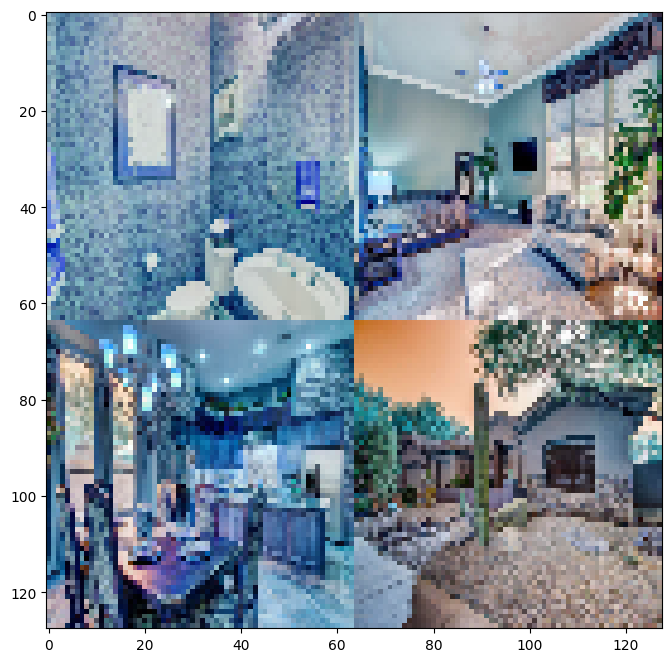

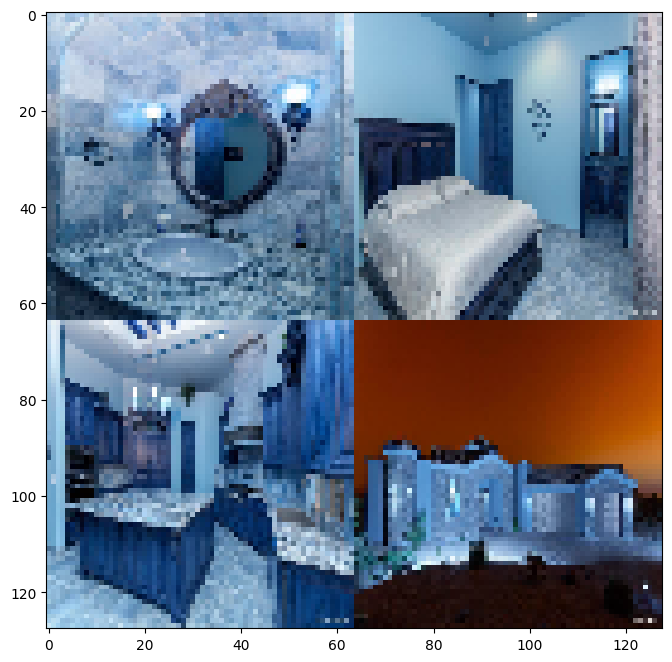

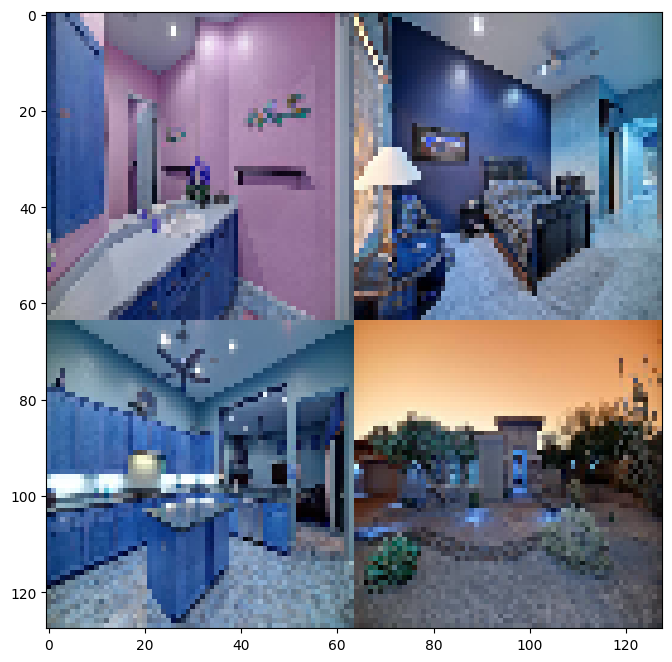

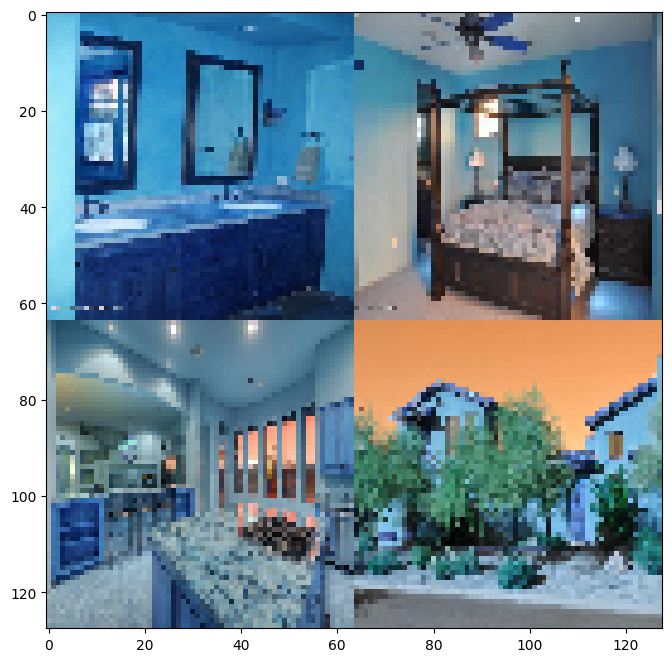

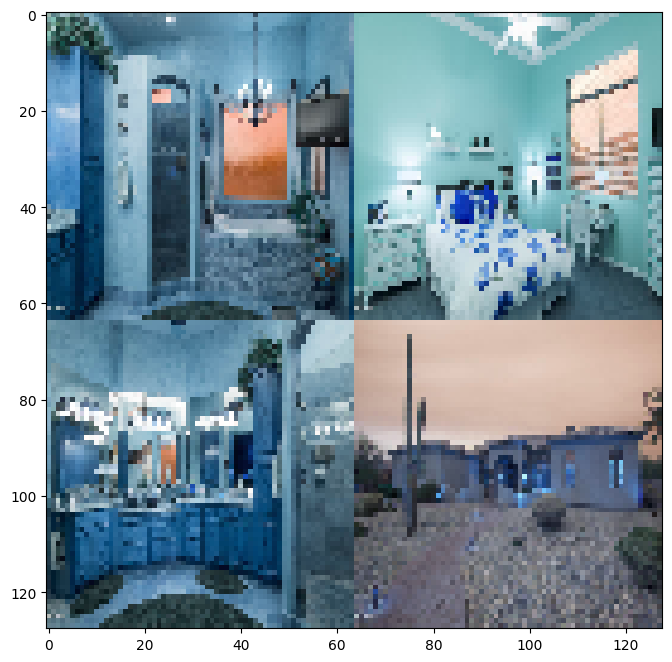

...

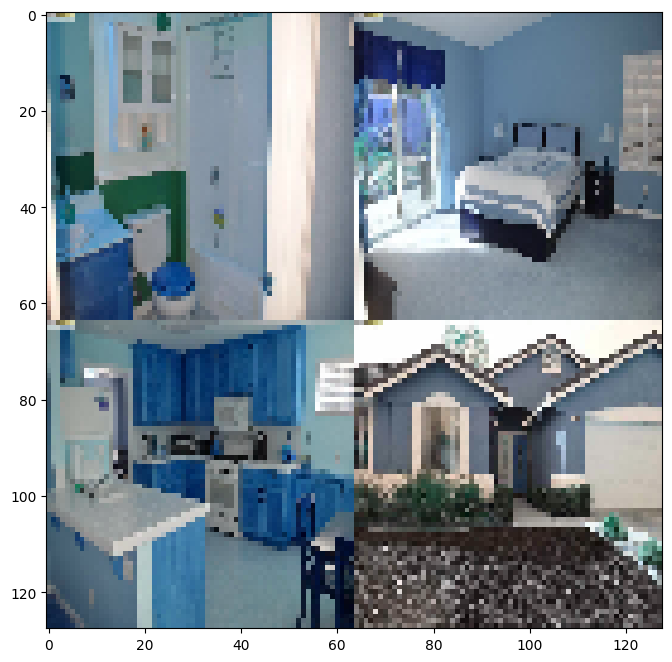

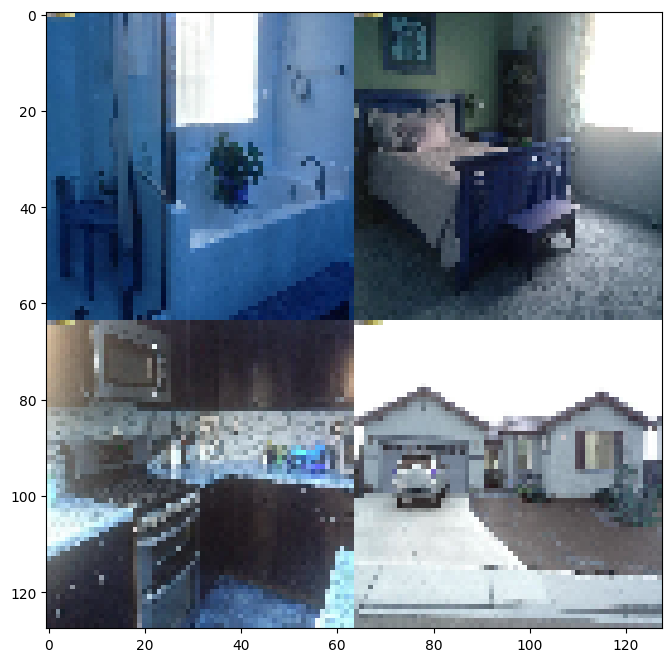

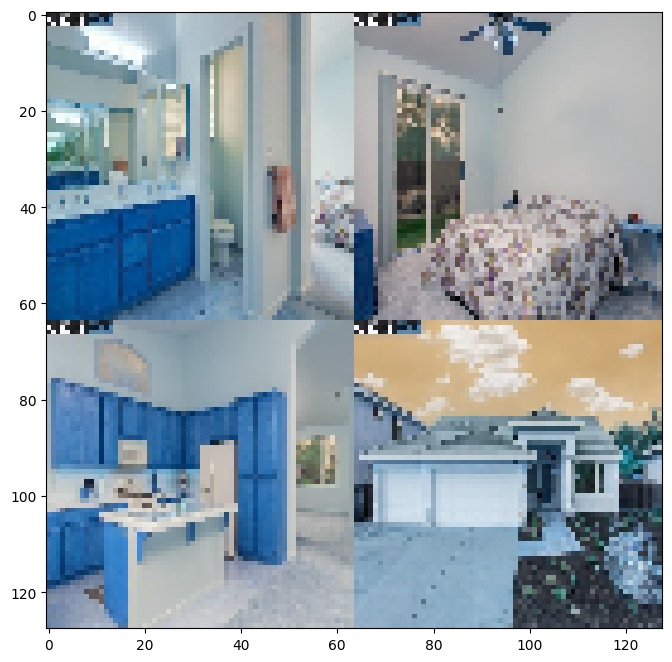

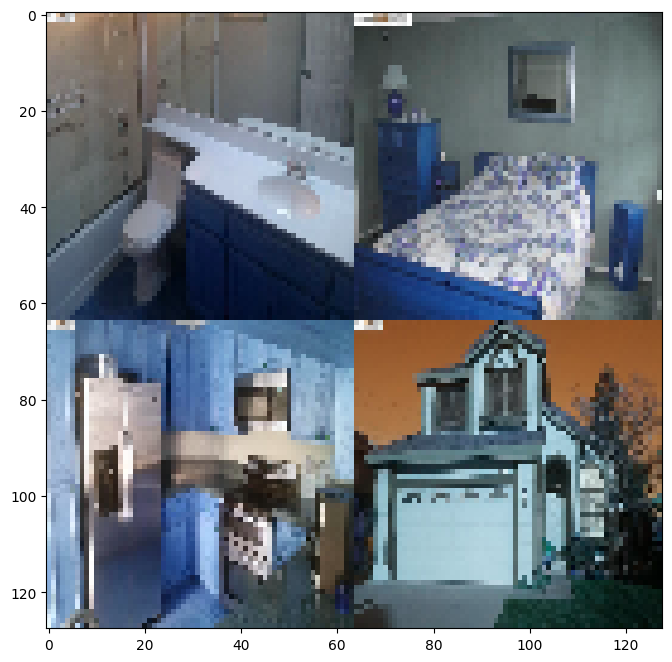

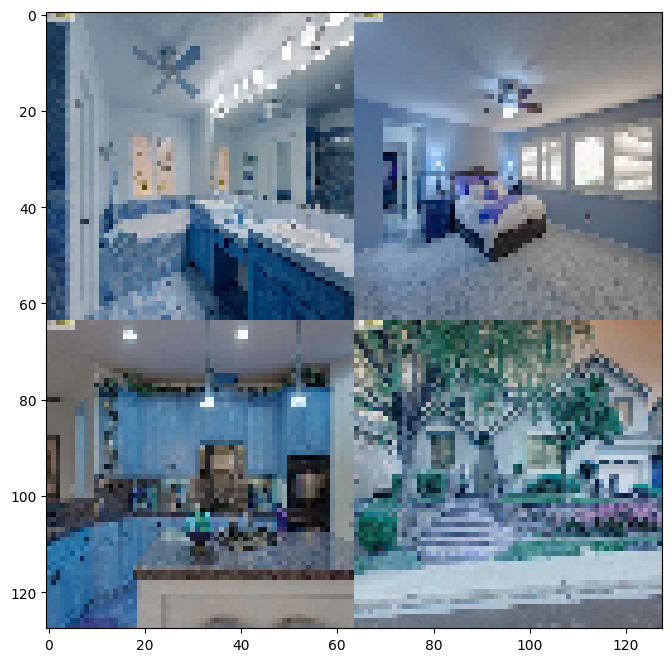

In [ ]:
from matplotlib import pyplot as plt

for i in images_output:
     plt.figure(figsize=(8,8))
     plt.imshow(i, interpolation='nearest')
     plt.show()

## <font color='red'>Create numpy arrays of images:</font>

In [ ]:
img_arr=np.asarray(images_output)
img_arr.shape

(405, 128, 128, 3)

In [ ]:
df.shape

(405, 44)

In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Dense, Activation
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.layers import Input
from tensorflow.keras.utils import plot_model
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import concatenate

In [ ]:
from sklearn.model_selection import train_test_split

# Splitting into training and testing dataset

In [ ]:
# Turn into numpy array and drop price column
x = np.asarray(df.drop('price', axis=1), dtype='float32')
y = np.asarray(df['price'], dtype='float32')

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.20, random_state=777)
x_train_image, x_test_image = train_test_split(img_arr, test_size=0.20, random_state=777)

In [ ]:
print(x_train.shape, x_test.shape, y_train.shape, y_test.shape)
print(x_train_image.shape, x_test_image.shape)

(324, 43) (81, 43) (324,) (81,)
(324, 128, 128, 3) (81, 128, 128, 3)


# Training Model

In [ ]:
import os
saved_path = './Prj3Models/'
if not os.path.exists(saved_path):
    os.makedirs(saved_path)

In [ ]:
# saved_path = './Prj3Models/'
# Save best model
checkpointer = ModelCheckpoint(filepath=os.path.join(saved_path, "relu_model.keras"), verbose=0, save_best_only=True)

# Loop model training 5 times
for i in range(5):
    print('\nRun', i + 1)

    # Input layer for text data
    input1 = Input(shape=(43,))
    flat = Flatten()(input1) # Flatten input data
    # Dense layers with ReLU activation
    dense1 = Dense(256, activation='relu')(flat)
    dense2 = Dense(128, activation='relu')(dense1)
    dense3 = Dense(64, activation='relu')(dense2)
    # Final layer to output 25 units
    text_model = Dense(25, activation='relu')(dense3)



    # Input layer for image data
    input2 = Input(shape=(128,128,3))
    # Convolution and MaxPooling layers for image processing
    conv1 = Conv2D(64, kernel_size=4, activation='relu')(input2)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)
    conv2 = Conv2D(32, kernel_size=4, activation='relu')(pool1)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)
    conv3 = Conv2D(16, kernel_size=4, activation='relu')(pool2)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)
    # Flatten the processed image data
    image_model = Flatten()(pool3)

    # Merge the two input models
    merge = concatenate([text_model, image_model]) # Concatenate the outputs from the text and image models


    # Additional Dense layers for interpretation
    hidden1 = Dense(50, activation='relu')(merge)
    hidden2 = Dense(30, activation='relu')(hidden1)
    hidden3 = Dense(15, activation='relu')(hidden2)
    output = Dense(1, activation='linear')(hidden3)


    relu_model = Model(inputs=[input1, input2], outputs=output)
    relu_model.compile( optimizer='adam', loss='mean_squared_error')

    monitor = EarlyStopping(monitor='val_loss', min_delta=1e-3, patience=12, verbose=1, mode='auto')

    relu_model.fit([x_train, x_train_image], y_train, validation_data=([x_test, x_test_image], y_test), callbacks=[monitor, checkpointer], verbose=2, epochs=1000)

print('Runs complete, saving model')
print()
relu_model.load_weights(os.path.join(saved_path, "relu_model.keras"))


Run 1
Epoch 1/1000
11/11 - 9s - 861ms/step - loss: 272922771456.0000 - val_loss: 312374362112.0000
Epoch 2/1000
11/11 - 5s - 431ms/step - loss: 227715547136.0000 - val_loss: 94205190144.0000
Epoch 3/1000
11/11 - 0s - 32ms/step - loss: 67499188224.0000 - val_loss: 66069225472.0000
Epoch 4/1000
11/11 - 1s - 52ms/step - loss: 58600828928.0000 - val_loss: 45193867264.0000
Epoch 5/1000
11/11 - 0s - 20ms/step - loss: 56408850432.0000 - val_loss: 62535770112.0000
Epoch 6/1000
11/11 - 0s - 34ms/step - loss: 51465555968.0000 - val_loss: 43443556352.0000
Epoch 7/1000
11/11 - 0s - 21ms/step - loss: 47671902208.0000 - val_loss: 47841042432.0000
Epoch 8/1000
11/11 - 0s - 28ms/step - loss: 46791421952.0000 - val_loss: 43506098176.0000
Epoch 9/1000
11/11 - 0s - 20ms/step - loss: 47209844736.0000 - val_loss: 50657443840.0000
Epoch 10/1000
11/11 - 0s - 28ms/step - loss: 49507241984.0000 - val_loss: 43109527552.0000
Epoch 11/1000
11/11 - 0s - 21ms/step - loss: 48454041600.0000 - val_loss: 43264446464.0

In [ ]:
print(relu_model.summary())

Model: "functional_14"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_29            │ (None, 128, 128, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_42 (Conv2D)        │ (None, 125, 125, 64)   │          3,136 │ input_layer_29[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ input_layer_28            │ (None, 43)             │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_42          │ (None, 62, 62, 64)     │              0 │ conv2d_42[0][0]        │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten_28 (Flatten)      │ (None, 43)             │              0 │ input_layer_28[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_43 (Conv2D)        │ (None, 59, 59, 32)     │         32,800 │ max_pooling2d_42[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_112 (Dense)         │ (None, 256)            │         11,264 │ flatten_28[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_43          │ (None, 29, 29, 32)     │              0 │ conv2d_43[0][0]        │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_113 (Dense)         │ (None, 128)            │         32,896 │ dense_112[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_44 (Conv2D)        │ (None, 26, 26, 16)     │          8,208 │ max_pooling2d_43[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_114 (Dense)         │ (None, 64)             │          8,256 │ dense_113[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_44          │ (None, 13, 13, 16)     │              0 │ conv2d_44[0][0]        │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_115 (Dense)         │ (None, 25)             │          1,625 │ dense_114[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten_29 (Flatten)      │ (None, 2704)           │              0 │ max_pooling2d_44[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_14            │ (None, 2729)           │              0 │ dense_115[0][0],       │
│ (Concatenate)             │                        │                │ flatten_29[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_116 (Dense)         │ (None, 50)             │        136,500 │ concatenate_14[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_117 (Dense)    

 Total params: 710,090 (2.71 MB)

 Trainable params: 236,696 (924.59 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 473,394 (1.81 MB)

None


# RMSE and Lift chart

In [ ]:

# Make predictions on the test set
y_pred = relu_model.predict([x_test, x_test_image])

# Calculate RMSE
rmse = np.sqrt(mean_squared_error(y_test, y_pred))

print(f"\nRoot Mean Squared Error (RMSE): {rmse:.2f}")


3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 140ms/step

Root Mean Squared Error (RMSE): 96898.33


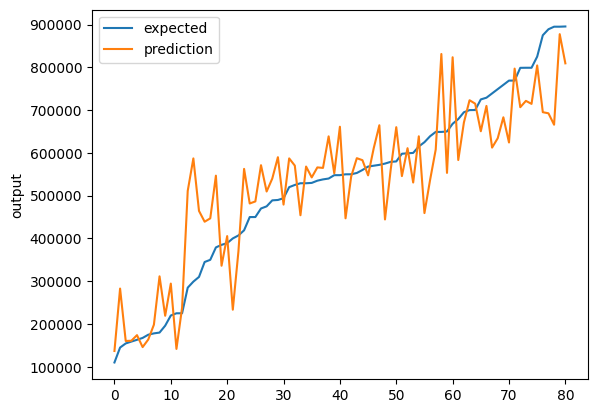

In [ ]:
chart_regression(y_pred.flatten(), y_test, sort= True)

# Additional features
## Using VGG16

In [ ]:
from keras.applications import VGG16
from keras.models import Model
from keras.layers import Input, Dense, Flatten, concatenate, GlobalAveragePooling2D
from keras.callbacks import ModelCheckpoint, EarlyStopping

checkpointer = ModelCheckpoint(filepath=os.path.join(saved_path, "vgg16_model.keras"), verbose=0, save_best_only=True)
# Load VGG16 model with pre-trained weights
vgg16_base = VGG16(weights='imagenet', include_top=False, input_shape=(128, 128, 3))

# Freeze VGG16 layers to prevent training
for layer in vgg16_base.layers:
    layer.trainable = False

# Add custom layers on top of VGG16
vgg16_output = vgg16_base.output
vgg16_output = GlobalAveragePooling2D()(vgg16_output)  # Add global average pooling

input_text = Input(shape=(43,))
flat_text = Flatten()(input_text)
dense_text1 = Dense(256, activation='relu')(flat_text)
dense_text2 = Dense(128, activation='relu')(dense_text1)
dense_text3 = Dense(64, activation='relu')(dense_text2)
text_model = Dense(25, activation='relu')(dense_text3)

# Concatenate VGG16 output with the text-based model
merge = concatenate([vgg16_output, text_model])

hidden1 = Dense(50, activation='relu')(merge)
hidden2 = Dense(30, activation='relu')(hidden1)
hidden3 = Dense(15, activation='relu')(hidden2)
output = Dense(1, activation='linear')(hidden3)

vgg16_model = Model(inputs=[input_text, vgg16_base.input], outputs=output)

vgg16_model.compile(optimizer='adam', loss='mean_squared_error')

checkpointer = ModelCheckpoint(filepath=os.path.join(saved_path, "vgg16_model.keras"), verbose=0, save_best_only=True)

monitor = EarlyStopping(monitor='val_loss', min_delta=1e-3, patience=12, verbose=1, mode='auto')

vgg16_model.fit([x_train, x_train_image], y_train, validation_data=([x_test, x_test_image], y_test), callbacks=[monitor, checkpointer], verbose=2, epochs=1000)

print('\nComplete, saving model')
vgg16_model.load_weights(os.path.join(saved_path, "vgg16_model.keras"))


Epoch 1/1000
11/11 - 8s - 767ms/step - loss: 273531322368.0000 - val_loss: 319340871680.0000
Epoch 2/1000
11/11 - 1s - 92ms/step - loss: 273490427904.0000 - val_loss: 319269765120.0000
Epoch 3/1000
11/11 - 1s - 107ms/step - loss: 273401151488.0000 - val_loss: 319104417792.0000
Epoch 4/1000
11/11 - 1s - 114ms/step - loss: 273198743552.0000 - val_loss: 318746427392.0000
Epoch 5/1000
11/11 - 1s - 82ms/step - loss: 272738353152.0000 - val_loss: 317894721536.0000
Epoch 6/1000
11/11 - 1s - 78ms/step - loss: 271611625472.0000 - val_loss: 315615150080.0000
Epoch 7/1000
11/11 - 4s - 378ms/step - loss: 268384763904.0000 - val_loss: 308996341760.0000
Epoch 8/1000
11/11 - 2s - 191ms/step - loss: 259082076160.0000 - val_loss: 289926873088.0000
Epoch 9/1000
11/11 - 1s - 102ms/step - loss: 233015672832.0000 - val_loss: 240411246592.0000
Epoch 10/1000
11/11 - 1s - 102ms/step - loss: 173819199488.0000 - val_loss: 139870797824.0000
Epoch 11/1000
11/11 - 1s - 77ms/step - loss: 84743872512.0000 - val_loss

In [ ]:
# Make predictions on the test set
y_pred = vgg16_model.predict([x_test, x_test_image])

# Calculate RMSE
rmse = np.sqrt(mean_squared_error(y_test, y_pred))

print(f"\nRoot Mean Squared Error (RMSE): {rmse:.2f}")

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step

Root Mean Squared Error (RMSE): 100346.78


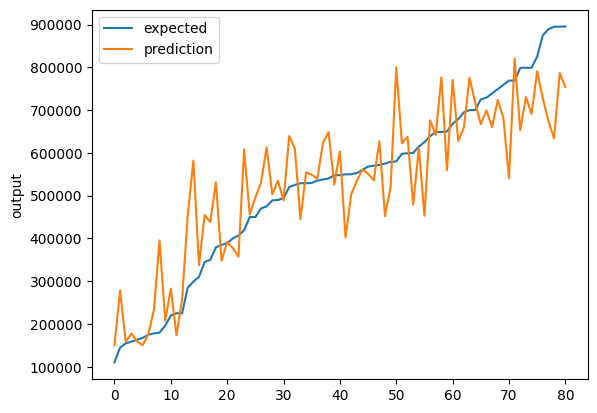

In [ ]:
chart_regression(y_pred.flatten(), y_test, sort= True)